# Associate Machine Learning Engineer Interview
# Panel 1

## 1. Data Preprocessing

### Import Libraries & Dataset

In [124]:
import pandas as pd
from pandas_profiling import ProfileReport

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

import warnings #Ignore all warnings
warnings.filterwarnings("ignore")

import itertools

from scipy import stats

import statsmodels.api as sm
from statsmodels.formula.api import ols
import statsmodels.stats.api as sms

from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.preprocessing import LabelEncoder, MaxAbsScaler, OneHotEncoder, PolynomialFeatures
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.feature_selection import RFE
from sklearn import metrics

In [3]:
data = pd.read_csv('kc_house_data.csv')
data_copy = data.copy()

### EDA

In [4]:
profile = ProfileReport(data, title= 'Pandas Profile Report')
profile

### Check Distribution

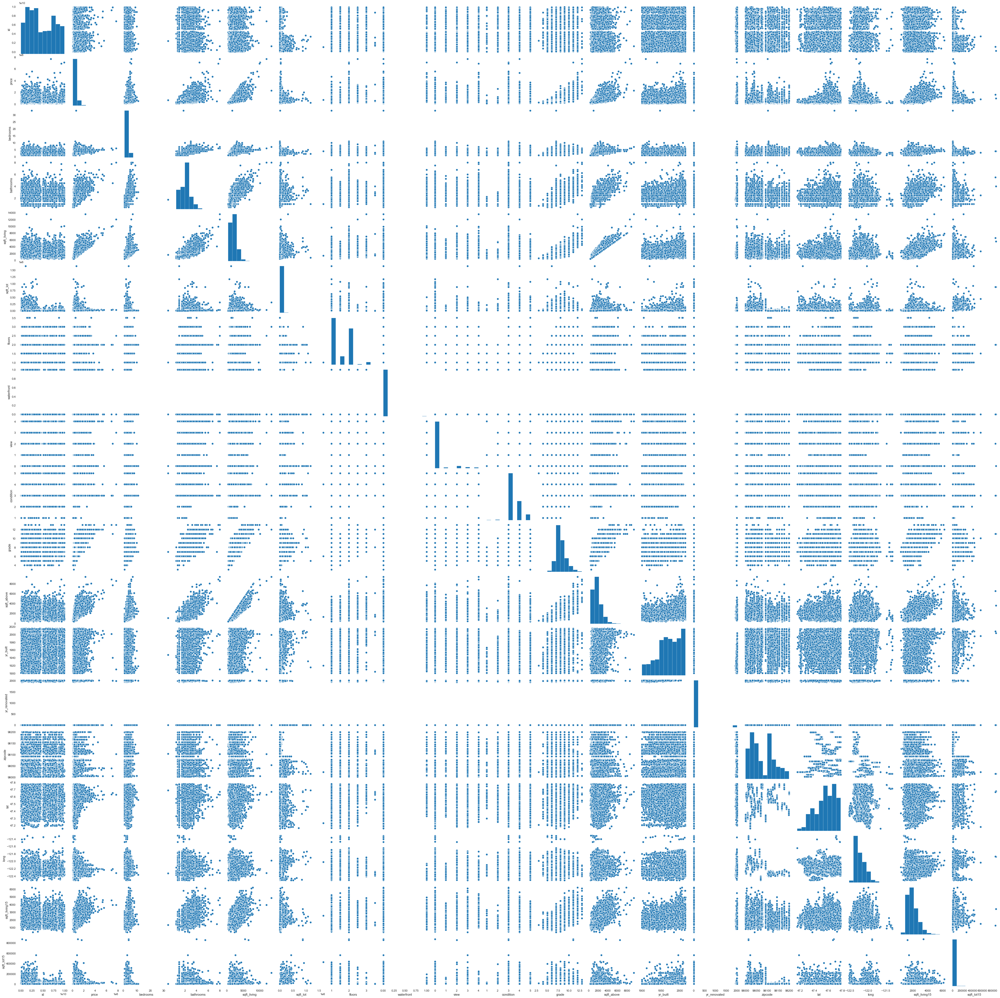

In [5]:
sns.pairplot(data)

In [6]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   id             21597 non-null  int64  
 1   date           21597 non-null  object 
 2   price          21597 non-null  float64
 3   bedrooms       21597 non-null  int64  
 4   bathrooms      21597 non-null  float64
 5   sqft_living    21597 non-null  int64  
 6   sqft_lot       21597 non-null  int64  
 7   floors         21597 non-null  float64
 8   waterfront     19221 non-null  float64
 9   view           21534 non-null  float64
 10  condition      21597 non-null  int64  
 11  grade          21597 non-null  int64  
 12  sqft_above     21597 non-null  int64  
 13  sqft_basement  21597 non-null  object 
 14  yr_built       21597 non-null  int64  
 15  yr_renovated   17755 non-null  float64
 16  zipcode        21597 non-null  int64  
 17  lat            21597 non-null  float64
 18  long  

In [7]:
data.shape

(21597, 21)

In [8]:
data.skew()

id                0.243226
price             4.023365
bedrooms          2.023641
bathrooms         0.519709
sqft_living       1.473215
sqft_lot         13.072604
floors            0.614497
waterfront       11.343651
view              3.399526
condition         1.036037
grade             0.788237
sqft_above        1.447434
yr_built         -0.469450
yr_renovated      4.573385
zipcode           0.405322
lat              -0.485522
long              0.884888
sqft_living15     1.106875
sqft_lot15        9.524362
dtype: float64

In [9]:
data.kurtosis()

id                -1.260750
price             34.541359
bedrooms          49.821835
bathrooms          1.279315
sqft_living        5.252102
sqft_lot         285.495812
floors            -0.491066
waterfront       126.691605
view              10.919713
condition          0.519237
grade              1.135148
sqft_above         3.405520
yr_built          -0.657694
yr_renovated      18.919543
zipcode           -0.854005
lat               -0.675790
long               1.052120
sqft_living15      1.591733
sqft_lot15       151.395663
dtype: float64

### Data Cleaning

#### Treat Null Values
* Waterfront
* View
* yr_renovated


In [10]:
data['yr_renovated'].fillna(data['yr_renovated'].median(), inplace=True)

In [11]:
data['view'].fillna(data['view'].mode()[0], inplace=True)

In [12]:
data['waterfront'].fillna(data['waterfront'].mode()[0], inplace=True)

#### Treat Extraneous Data

In [13]:
data['sqft_basement'].mode()

0    0.0
dtype: object

In [14]:
data['sqft_basement'] = data['sqft_basement'].replace('?','0')


#### Convert Data Types
* sqft_basement
* date
* yr_built
* yr_renovated

In [15]:
data['sqft_basement'] = data['sqft_basement'].astype('float')

In [16]:
data['date'] = pd.to_datetime(data['date']) 


In [17]:
data['yr_built'] = pd.to_datetime(data['yr_built'])

In [18]:
data['id'] = data['id'].astype('object')

#### Sanity Check

In [19]:
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 21597 entries, 0 to 21596
Data columns (total 21 columns):
 #   Column         Non-Null Count  Dtype         
---  ------         --------------  -----         
 0   id             21597 non-null  object        
 1   date           21597 non-null  datetime64[ns]
 2   price          21597 non-null  float64       
 3   bedrooms       21597 non-null  int64         
 4   bathrooms      21597 non-null  float64       
 5   sqft_living    21597 non-null  int64         
 6   sqft_lot       21597 non-null  int64         
 7   floors         21597 non-null  float64       
 8   waterfront     21597 non-null  float64       
 9   view           21597 non-null  float64       
 10  condition      21597 non-null  int64         
 11  grade          21597 non-null  int64         
 12  sqft_above     21597 non-null  int64         
 13  sqft_basement  21597 non-null  float64       
 14  yr_built       21597 non-null  datetime64[ns]
 15  yr_renovated   2159

In [20]:
data['is_renovated'] = np.where(data['yr_renovated']> 0, 1, 0)

In [21]:
data.yr_renovated.head()

0       0.0
1    1991.0
2       0.0
3       0.0
4       0.0
Name: yr_renovated, dtype: float64

In [22]:
data.is_renovated.head()

0    0
1    1
2    0
3    0
4    0
Name: is_renovated, dtype: int64

#### Check for Outliers

In [23]:
nums = data.select_dtypes(include='number')

In [24]:
cats = data.select_dtypes(exclude='number')

In [25]:
z = np.abs(stats.zscore(nums))

In [26]:
no_nums = nums[(z < 2).all(axis=1)]


In [27]:
no_nums.shape

(13208, 19)

In [28]:
no_data = pd.concat([no_nums, cats], axis=1, join='inner') 

In [29]:
no_data.shape

(13208, 22)

##### Skew Check

In [30]:
no_data.skew()

price            0.971937
bedrooms         0.194545
bathrooms       -0.124289
sqft_living      0.420499
sqft_lot         4.199767
floors           0.256329
waterfront       0.000000
view             8.751936
condition        0.826126
grade            0.581803
sqft_above       0.773098
sqft_basement    1.300967
yr_renovated     0.000000
zipcode          0.330839
lat             -0.338748
long             0.317411
sqft_living15    0.558763
sqft_lot15       3.714272
is_renovated     0.000000
id               0.223551
dtype: float64

#### Correlation Testing

<AxesSubplot:>

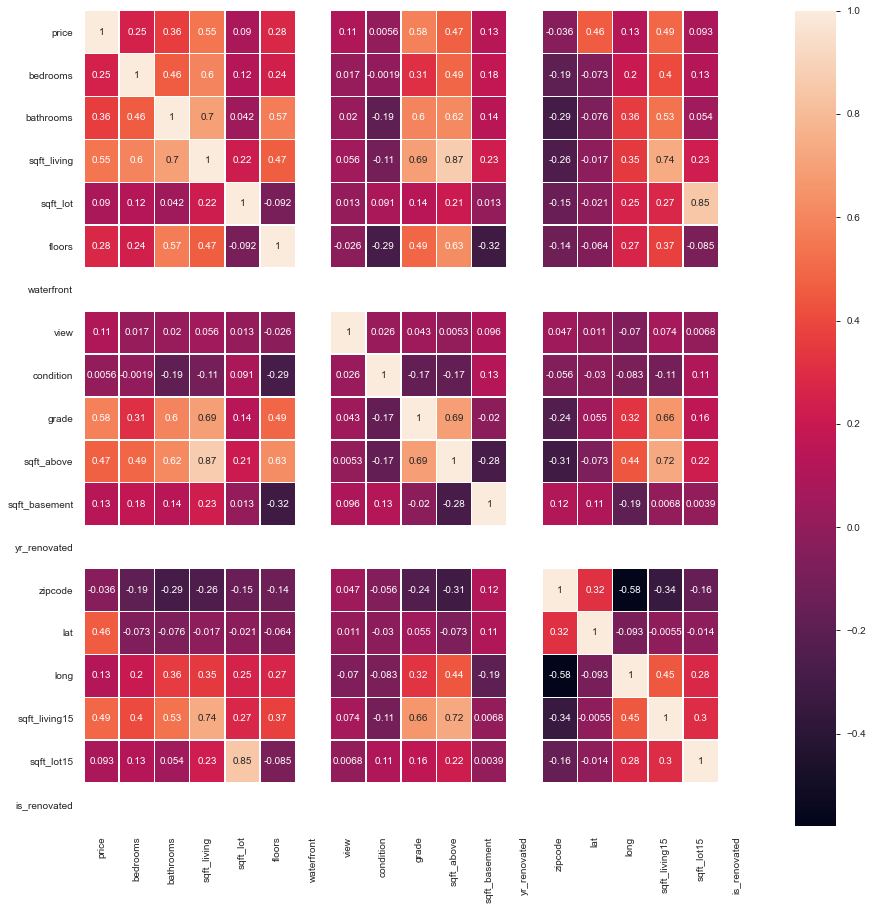

In [31]:
fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(no_data.corr(), annot=True, linewidth=.5, ax=ax)
# b, t = plt.ylim() # discover the values for bottom and top
# b += 0.5 # Add 0.5 to the bottom
# t -= 0.5 # Subtract 0.5 from the top
# plt.ylim(b, t) # update the ylim(bottom, top) values
# plt.show()

#### Identify & Remove Features with Correlations of >0.70

In [32]:
corr_mtx = no_data.corr().abs()
upper = corr_mtx.where(np.triu(np.ones(corr_mtx.shape), k=1).astype(np.bool))
high_corr = [column for column in upper.columns if any(upper[column] > 0.70)]
high_corr

['sqft_above', 'sqft_living15', 'sqft_lot15']

##### Feats to drop
* yr_renovated
* corrs
* unhelpful feats

<AxesSubplot:>

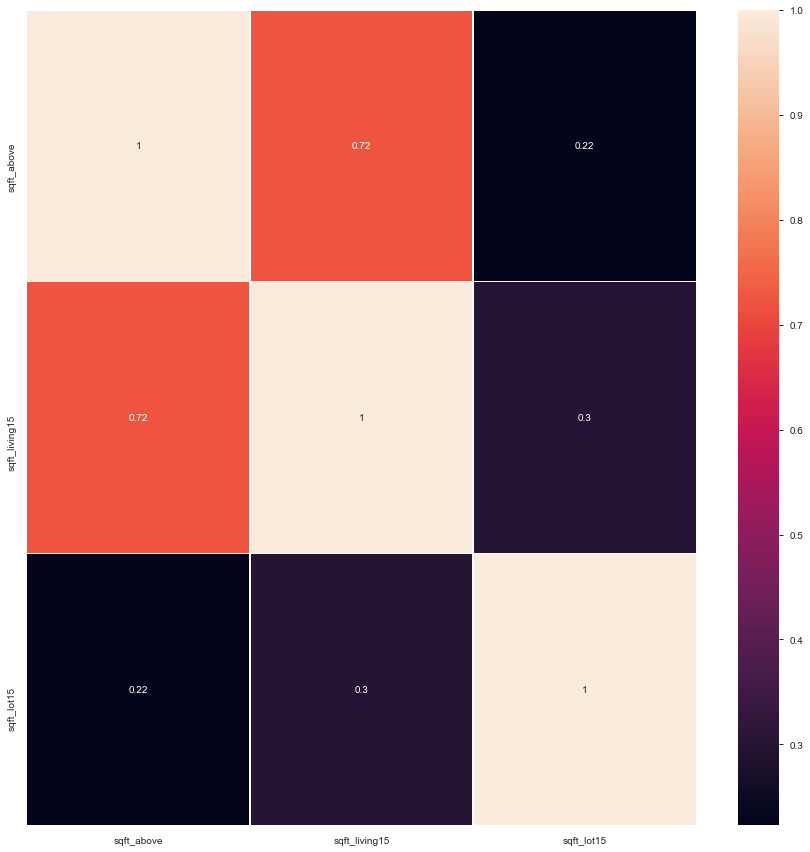

In [33]:
fig, ax = plt.subplots(figsize=(15,15))
sns.heatmap(no_data[high_corr].corr(), annot=True, linewidth=.5, ax=ax)

In [34]:
# Drop High Corr Features
no_data = no_data.drop(['sqft_lot15', 'sqft_living15','sqft_above'], axis=1)

In [35]:
no_data.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_basement,yr_renovated,zipcode,lat,long,is_renovated,id,date,yr_built
0,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,0.0,0.0,98178,47.5112,-122.257,0,7129300520,2014-10-13,1970-01-01 00:00:00.000001955
2,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,0.0,0.0,98028,47.7379,-122.233,0,5631500400,2015-02-25,1970-01-01 00:00:00.000001933
4,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,0.0,0.0,98074,47.6168,-122.045,0,1954400510,2015-02-18,1970-01-01 00:00:00.000001987
6,257500.0,3,2.25,1715,6819,2.0,0.0,0.0,3,7,0.0,0.0,98003,47.3097,-122.327,0,1321400060,2014-06-27,1970-01-01 00:00:00.000001995
8,229500.0,3,1.00,1780,7470,1.0,0.0,0.0,3,7,730.0,0.0,98146,47.5123,-122.337,0,2414600126,2015-04-15,1970-01-01 00:00:00.000001960


drop
* id
* do something about zipcode
* feat engineer date to get year, month, weekday

### Hypothesis Testing

* Alternative Hypothesis 1: Homes with a view will sell for greater prices that homes without.
* Null Hypothesis 1: Homes with a view will sell for the same price as homes without.
    
* Atl Hypothesis 2: Lat and Long do not effect whether or not a home will sell.
* Null Hypothesis 2:
    
* Alternative Hypothesis 3: Homes that are renovated will sell for greater prices that homes that are not.
* Null Hypothesis 3: Homes that are renovated will sell for the same price as homes without.

#### Hypothesis 1: Homes with a view will sell for greater prices that homes without.

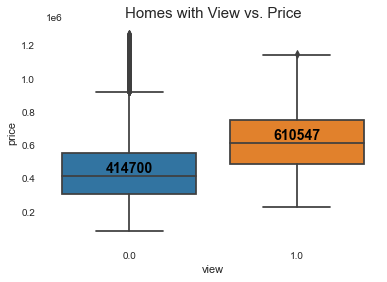

In [36]:
ax = sns.boxplot(x='view', y='price', data=no_data)
ax.set_title('Homes with View vs. Price', fontsize = 15)

medians = no_data.groupby(['view'])['price'].median().astype(int)
vertical_offset = no_data['price'].median() * 0.05

for xtick in ax.get_xticks():
    ax.text(xtick, medians[xtick] + vertical_offset, 
                                    medians[xtick], horizontalalignment='center', size=14, color='black', weight='bold')

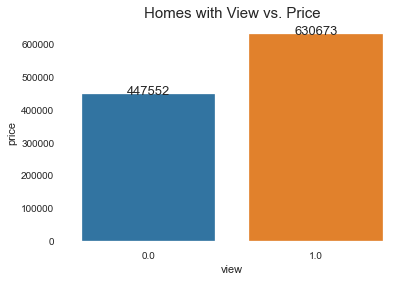

In [41]:
def show_values_on_bars(axs):
    def _show_on_single_plot(ax):        
        for p in ax.patches:
            _x = p.get_x() + p.get_width() / 2
            _y = p.get_y() + p.get_height()
            value = '{:.0f}'.format(int(p.get_height()))
            ax.text(_x, _y, value, ha="center", size=13) 

    if isinstance(axs, np.ndarray):
        for idx, ax in np.ndenumerate(axs):
            _show_on_single_plot(ax)
    else:
        _show_on_single_plot(axs)

ax = sns.barplot(x='view', y='price', data=no_data, ci=None)
ax.set_title('Homes with View vs. Price', fontsize = 15)
show_values_on_bars(ax)

#### Alternative Hypothesis 1: Homes with a view sell for greater prices that homes without.

#### Hypothesis 2:  Lat and Long do not effect whether or not a home will sell.

In [ ]:
# def jointer(x,y,z):
#     g = sns.JointGrid(data=d, x=x, y=y)
#     return g
# g = jointer("no_data","lat","price")

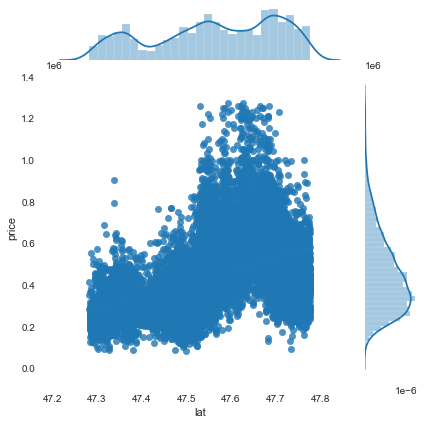

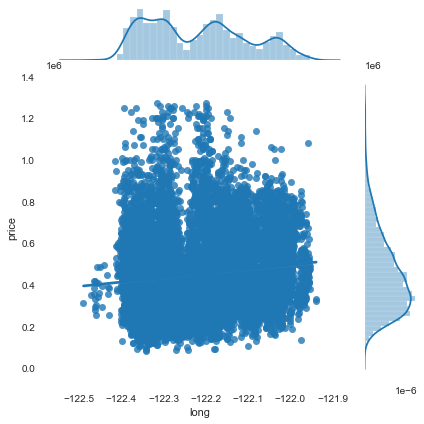

In [42]:
# fig = plt.figure();   
# ax1 = fig.add_subplot(121);  
# ax2 = fig.add_subplot(122);

sns.jointplot("lat", "price", data=no_data, kind='reg')
sns.jointplot("long", "price", data=no_data, kind='reg')

In [ ]:
# # Latitude

# ax = sns.boxplot(x='lat', y='price', data=no_data)
# ax.set_title('Lat vs. Price', fontsize = 15)

# medians = no_data.groupby(['lat'])['price'].median().astype(int)
# vertical_offset = no_data['price'].median() * 0.05

# for xtick in ax.get_xticks():
#     ax.text(xtick, medians[xtick] + vertical_offset, 
#                                     medians[xtick], horizontalalignment='center', size=14, color='black', weight='bold')

In [ ]:
# ax = sns.barplot(x='lat', y='price', data=no_data)
# ax.set_title('Lat vs. Price', fontsize = 15)
# show_values_on_bars(ax)

In [ ]:
# # Longitude
# ax = sns.boxplot(x='long', y='price', data=no_data)
# ax.set_title('Long vs. Price', fontsize = 15)

# medians = no_data.groupby(['long'])['price'].median().astype(int)
# vertical_offset = no_data['price'].median() * 0.05

# for xtick in ax.get_xticks():
#     ax.text(xtick, medians[xtick] + vertical_offset, 
#                                     medians[xtick], horizontalalignment='center', size=14, color='black', weight='bold')

In [ ]:
# ax = sns.barplot(x='long', y='price', data=no_data)
# ax.set_title('Long vs. Price', fontsize = 15)
# show_values_on_bars(ax)

#### Hypothesis 3: Homes that are renovated will sell for greater prices that homes that are not.

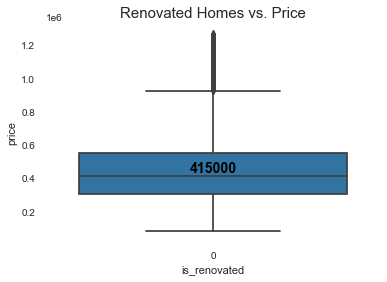

In [43]:
ax = sns.boxplot(x='is_renovated', y='price', data=no_data)
ax.set_title('Renovated Homes vs. Price', fontsize = 15)

medians = no_data.groupby(['is_renovated'])['price'].median().astype(int)
vertical_offset = no_data['price'].median() * 0.05

for xtick in ax.get_xticks():
    ax.text(xtick, medians[xtick] + vertical_offset, 
                                    medians[xtick], horizontalalignment='center', size=14, color='black', weight='bold')

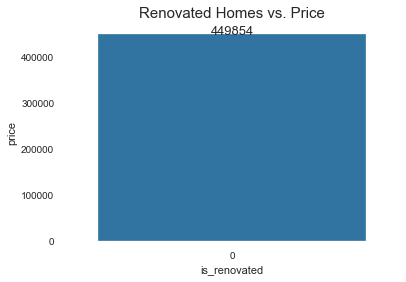

In [45]:
ax = sns.barplot(x='is_renovated', y='price', data=no_data, ci=None)
ax.set_title('Renovated Homes vs. Price', fontsize = 15)
show_values_on_bars(ax)

Hypothesis 3, Null Hypothesis is Valid

#### Feature Engineering

In [46]:
# Extract Year
no_data['year_purchased'] = pd.DatetimeIndex(no_data['date']).year

In [47]:
# Extract Month
no_data['month_pur'] = pd.DatetimeIndex(no_data['date']).month

In [48]:
no_data.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,...,yr_renovated,zipcode,lat,long,is_renovated,id,date,yr_built,year_purchased,month_pur
0,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,...,0.0,98178,47.5112,-122.257,0,7129300520,2014-10-13,1970-01-01 00:00:00.000001955,2014,10
2,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,...,0.0,98028,47.7379,-122.233,0,5631500400,2015-02-25,1970-01-01 00:00:00.000001933,2015,2
4,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,...,0.0,98074,47.6168,-122.045,0,1954400510,2015-02-18,1970-01-01 00:00:00.000001987,2015,2
6,257500.0,3,2.25,1715,6819,2.0,0.0,0.0,3,7,...,0.0,98003,47.3097,-122.327,0,1321400060,2014-06-27,1970-01-01 00:00:00.000001995,2014,6
8,229500.0,3,1.00,1780,7470,1.0,0.0,0.0,3,7,...,0.0,98146,47.5123,-122.337,0,2414600126,2015-04-15,1970-01-01 00:00:00.000001960,2015,4


In [49]:
# Extract Year
no_data['year_built'] = pd.DatetimeIndex(no_data['date']).year

In [50]:
no_data = no_data.drop(['yr_built'], axis=1)

In [51]:
# Evaluate whether or not to keep this feature
no_data.zipcode.value_counts()

98038    481
98052    456
98034    434
98042    426
98023    412
        ... 
98148     49
98010     46
98070     25
98039      7
98014      6
Name: zipcode, Length: 63, dtype: int64

#### Model_Dataset

In [53]:
no_data = no_data.drop(['id', 'lat', 'long', 'is_renovated'], axis=1)

In [97]:
no_data = no_data.drop(['date', 'yr_renovated'], axis=1)

In [98]:
model_dataset = no_data.copy()

In [99]:
model_dataset_copy = model_dataset.copy()

In [100]:
model_dataset.head()

,price,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_basement,zipcode,year_purchased,month_pur,year_built
0,221900.0,3,1.00,1180,5650,1.0,0.0,0.0,3,7,0.0,98178,2014,10,2014
2,180000.0,2,1.00,770,10000,1.0,0.0,0.0,3,6,0.0,98028,2015,2,2015
4,510000.0,3,2.00,1680,8080,1.0,0.0,0.0,3,8,0.0,98074,2015,2,2015
6,257500.0,3,2.25,1715,6819,2.0,0.0,0.0,3,7,0.0,98003,2014,6,2014
8,229500.0,3,1.00,1780,7470,1.0,0.0,0.0,3,7,730.0,98146,2015,4,2015


In [101]:
model_dataset.isnull().sum()

price             0
bedrooms          0
bathrooms         0
sqft_living       0
sqft_lot          0
floors            0
waterfront        0
view              0
condition         0
grade             0
sqft_basement     0
zipcode           0
year_purchased    0
month_pur         0
year_built        0
dtype: int64

### Modeling

#### Train-Test Split

In [102]:
Y = model_dataset['price']
X = model_dataset.drop(['price'], axis=1)

In [103]:
X.isnull().sum()

bedrooms          0
bathrooms         0
sqft_living       0
sqft_lot          0
floors            0
waterfront        0
view              0
condition         0
grade             0
sqft_basement     0
zipcode           0
year_purchased    0
month_pur         0
year_built        0
dtype: int64

In [112]:
X.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 13208 entries, 0 to 21596
Data columns (total 14 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   bedrooms        13208 non-null  int64  
 1   bathrooms       13208 non-null  float64
 2   sqft_living     13208 non-null  int64  
 3   sqft_lot        13208 non-null  int64  
 4   floors          13208 non-null  float64
 5   waterfront      13208 non-null  float64
 6   view            13208 non-null  float64
 7   condition       13208 non-null  int64  
 8   grade           13208 non-null  int64  
 9   sqft_basement   13208 non-null  float64
 10  zipcode         13208 non-null  int64  
 11  year_purchased  13208 non-null  int64  
 12  month_pur       13208 non-null  int64  
 13  year_built      13208 non-null  int64  
dtypes: float64(5), int64(9)
memory usage: 1.5 MB


In [104]:
Y.isnull().sum()

0

In [105]:
X_train, X_test, y_train, y_test = train_test_split(X,Y, random_state=20, test_size=0.30)

In [106]:
# cont_features = X.select_dtypes(include='number')
# cat_features = X.select_dtypes(include='number')

In [107]:
# cont_col = cont_features.columns
# cat_col = cat_features.columns

In [108]:
# # Remove Continuous Feats from X_train & X_test
# Xtrain_nums = X_train.select_dtypes(include='number')
# Xtest_nums = X_test.select_dtypes(include='number')

In [113]:
# Xtrain_cats = X_train.select_dtypes(exclude='number')
# Xtest_cats = X_test.select_dtypes(exclude='number')

In [114]:
X_cols = X.columns

In [115]:
transformer = MaxAbsScaler()

In [116]:
Xtrain_trfm = transformer.fit_transform(X_train)
Xtest_trfm = transformer.transform(X_test)

In [117]:
X_train_final = pd.concat([pd.DataFrame(Xtrain_trfm, columns=X_cols)], axis=1)
X_test_final = pd.concat([pd.DataFrame(Xtest_trfm, columns=X_cols)], axis=1)

In [118]:
X_train_final.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_basement,zipcode,year_purchased,month_pur,year_built
0,0.8,0.785714,0.982005,0.269299,0.8,0.0,0.0,0.75,0.9,0.836207,0.998472,0.999504,0.916667,0.999504
1,0.6,0.714286,0.431877,0.115829,0.4,0.0,0.0,0.75,0.7,0.517241,0.999674,0.999504,0.583333,0.999504
2,0.6,0.500000,0.485861,0.067140,0.4,0.0,0.0,0.75,0.8,0.000000,0.999460,0.999504,0.916667,0.999504
3,1.0,0.785714,0.647815,0.047542,0.6,0.0,0.0,1.00,0.8,0.344828,0.999328,1.000000,0.250000,1.000000
4,0.8,0.857143,0.809769,0.067570,0.8,0.0,0.0,0.75,0.9,0.000000,0.998757,1.000000,0.416667,1.000000


In [119]:
X_test_final.head()

,bedrooms,bathrooms,sqft_living,sqft_lot,floors,waterfront,view,condition,grade,sqft_basement,zipcode,year_purchased,month_pur,year_built
0,0.4,0.285714,0.195373,0.061437,0.4,0.0,0.0,1.00,0.6,0.000000,0.999542,0.999504,0.833333,0.999504
1,0.8,0.642857,0.593830,0.076694,0.8,0.0,0.0,0.75,0.8,0.000000,0.998747,0.999504,0.416667,0.999504
2,0.4,0.500000,0.311054,0.042402,0.4,0.0,0.0,1.00,0.7,0.258621,0.999379,0.999504,1.000000,0.999504
3,0.6,0.785714,0.552699,0.067335,0.4,0.0,0.0,1.00,0.7,0.215517,0.999766,1.000000,0.250000,1.000000
4,0.8,0.714286,0.593830,0.063485,0.8,0.0,0.0,0.75,0.8,0.000000,0.999124,0.999504,0.750000,0.999504


Drop Date and yr_renovated cause I forgot

In [120]:
X_test_final.isnull().sum()

bedrooms          0
bathrooms         0
sqft_living       0
sqft_lot          0
floors            0
waterfront        0
view              0
condition         0
grade             0
sqft_basement     0
zipcode           0
year_purchased    0
month_pur         0
year_built        0
dtype: int64

In [121]:
X_train_final.isnull().sum()

bedrooms          0
bathrooms         0
sqft_living       0
sqft_lot          0
floors            0
waterfront        0
view              0
condition         0
grade             0
sqft_basement     0
zipcode           0
year_purchased    0
month_pur         0
year_built        0
dtype: int64

#### Baseline Model

In [130]:
def run_model(model, X_train, X_test, y_train, y_test):
    print('Training R^2: ', model.score(X_train, y_train))
    y_pred_train = model.predict(X_train)
    print('Training Root Mean Square Error', np.sqrt(metrics.mean_squared_error(y_train, y_pred_train)))
    print('\n----------------\n')
    print('Testing R^2: ', model.score(X_test, y_test))
    y_pred_test = model.predict(X_test)
    print('Testing Root Mean Square Error', np.sqrt(metrics.mean_squared_error(y_test, y_pred_test)))

In [131]:
linreg = LinearRegression()
linreg.fit(X_train_final, y_train)
run_model(linreg, X_train_final, X_test_final, y_train, y_test)

Training R^2:  0.43102476837707726
Training Root Mean Square Error 142870.92068809926

----------------

Testing R^2:  0.4179165402805075
Testing Root Mean Square Error 143132.35031467662


### Model Fit Summary

In [133]:
from statsmodels.formula.api import ols

In [134]:
predictor_sum = '+'.join(X.columns)

In [136]:
# formula = Y + '~' + predictor_sum
#  trouble shoot later

In [ ]:
# poly = PolynomialFeatures(degree=2, interaction_only=False, include_bias=False)
# X_poly_train = pd.DataFrame(poly.fit_transform(X_train_transformed), columns=poly.get_feature_names(features.columns))
# X_poly_test = pd.DataFrame(poly.transform(X_test_transformed), columns=poly.get_feature_names(features.columns))
# X_poly_train.head()